In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from astropy.coordinates import SkyCoord, Galactocentric
from astropy import units as u
import seaborn as sns
import plotly.express as px
from IPython.display import HTML

# Load and clean data
gaia_df = pd.read_csv("Query-3.csv").dropna(subset=['ra', 'dec', 'parallax'])
gaia_df['distance_pc'] = 1000 / gaia_df['parallax']

# Convert to galactocentric coordinates
coords_icrs = SkyCoord(
    ra=gaia_df['ra'].values * u.deg,
    dec=gaia_df['dec'].values * u.deg,
    distance=gaia_df['distance_pc'].values * u.pc,
    frame='icrs'
)
coords_galcen = coords_icrs.transform_to(Galactocentric())

gaia_df['x_galcen_kpc'] = coords_galcen.x.to(u.kpc).value
gaia_df['y_galcen_kpc'] = coords_galcen.y.to(u.kpc).value
gaia_df['z_galcen_kpc'] = coords_galcen.z.to(u.kpc).value


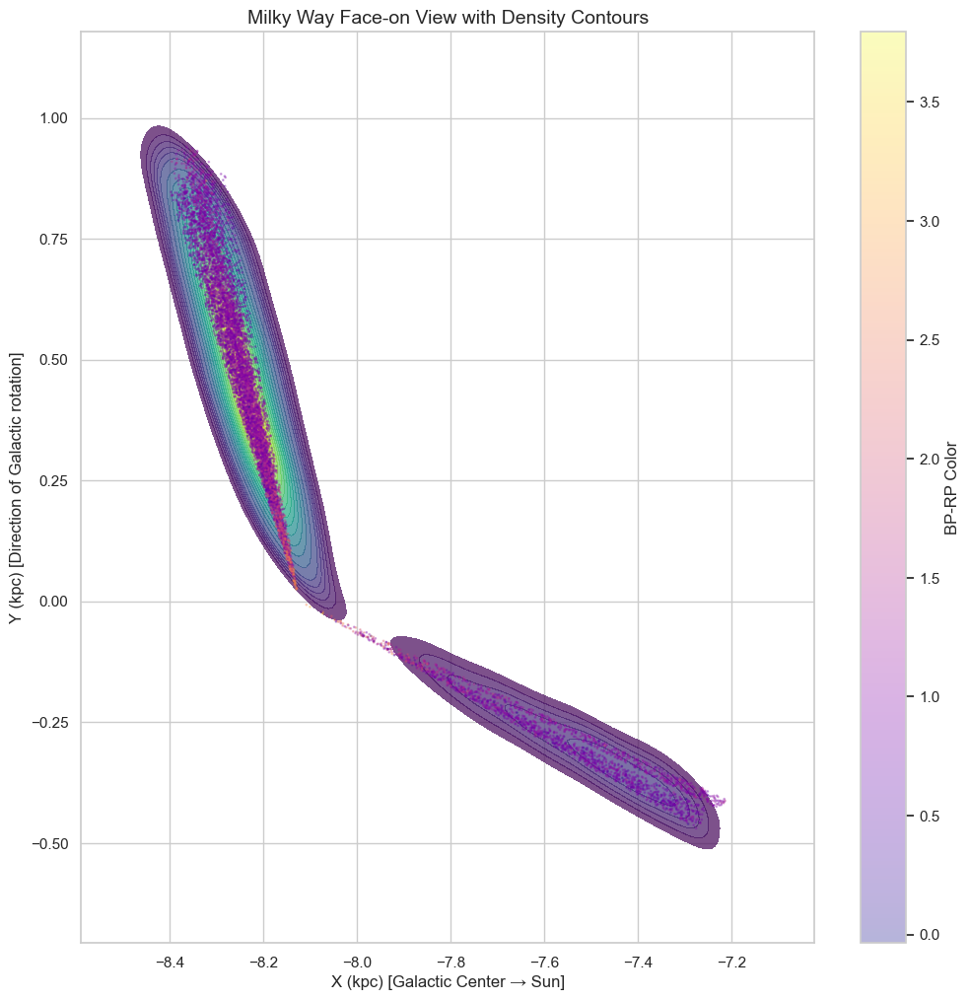

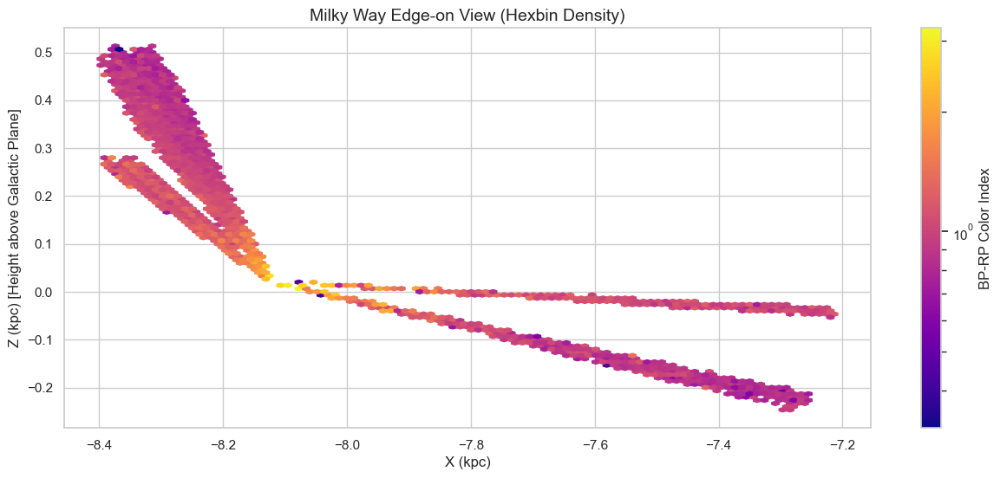

In [2]:
# Set seaborn style
sns.set(style="whitegrid", palette="muted")

# Face-on view with density contours
plt.figure(figsize=(12, 12))
sns.kdeplot(
    x=gaia_df['x_galcen_kpc'], 
    y=gaia_df['y_galcen_kpc'],
    cmap="viridis",
    fill=True,
    thresh=0.1,
    levels=20,
    alpha=0.7
)
plt.scatter(
    gaia_df['x_galcen_kpc'], 
    gaia_df['y_galcen_kpc'],
    c=gaia_df['bp_rp'],
    cmap='plasma',
    s=1,
    alpha=0.3
)
plt.colorbar(label='BP-RP Color')
plt.title('Milky Way Face-on View with Density Contours', fontsize=14)
plt.xlabel('X (kpc) [Galactic Center → Sun]')
plt.ylabel('Y (kpc) [Direction of Galactic rotation]')
plt.savefig('face_on_view.png', dpi=300, bbox_inches='tight')
plt.show()

# Edge-on view with better styling
plt.figure(figsize=(15, 6))
plt.hexbin(
    gaia_df['x_galcen_kpc'],
    gaia_df['z_galcen_kpc'],
    C=gaia_df['bp_rp'],
    gridsize=100,
    cmap='plasma',
    bins='log'
)
plt.colorbar(label='BP-RP Color Index')
plt.title('Milky Way Edge-on View (Hexbin Density)', fontsize=14)
plt.xlabel('X (kpc)')
plt.ylabel('Z (kpc) [Height above Galactic Plane]')
plt.savefig('edge_on_view.png', dpi=300, bbox_inches='tight')
plt.show()

In [4]:
# Create interactive 3D plot - with size check
sample_size = min(20000, len(gaia_df))  # Take whichever is smaller
fig = px.scatter_3d(
    gaia_df.sample(sample_size) if sample_size < len(gaia_df) else gaia_df,
    x='x_galcen_kpc',
    y='y_galcen_kpc',
    z='z_galcen_kpc',
    color='bp_rp',
    color_continuous_scale='plasma',
    opacity=0.7,
    title=f'3D Gaia Star Distribution (Interactive) - {sample_size} stars',
    labels={
        'x_galcen_kpc': 'X (kpc)',
        'y_galcen_kpc': 'Y (kpc)',
        'z_galcen_kpc': 'Z (kpc)',
        'bp_rp': 'BP-RP Color'
    }
)

# Improve layout
fig.update_layout(
    scene=dict(
        xaxis_title='X (kpc) → Galactic Center',
        yaxis_title='Y (kpc) → Rotation',
        zaxis_title='Z (kpc) ↑ Galactic North',
        aspectmode='data'
    ),
    coloraxis_colorbar=dict(title='BP-RP Color')
)

# Save as HTML for interactive viewing
fig.write_html("3d_interactive_view.html")
fig.show()

Animation size has reached 21099802 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


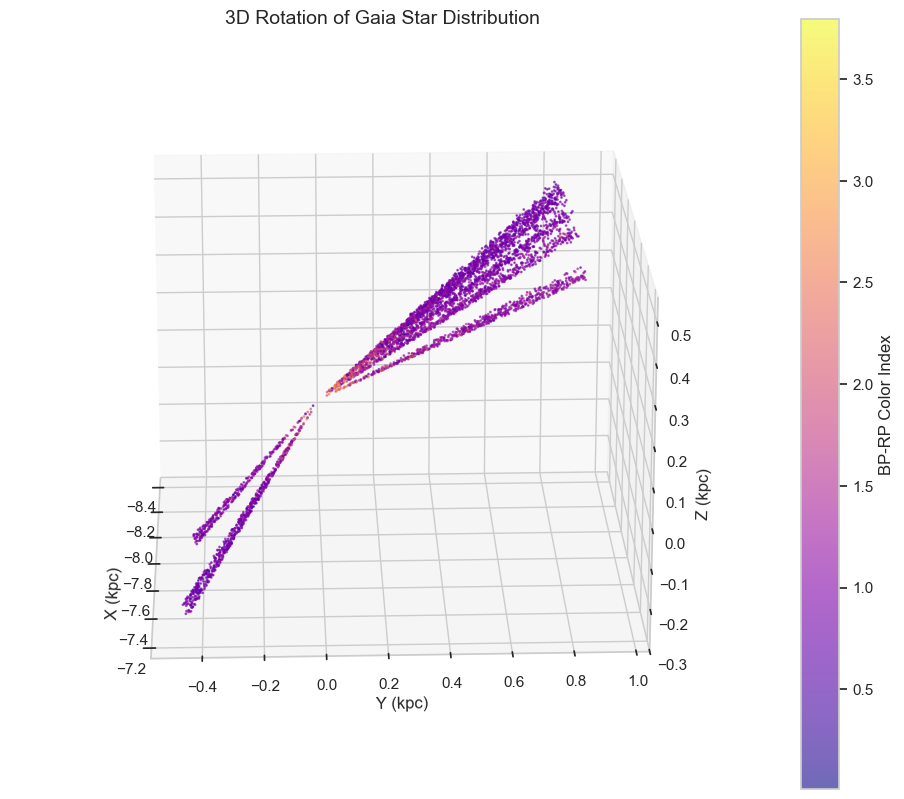

In [5]:
from matplotlib.animation import FuncAnimation
from mpl_toolkits.mplot3d import Axes3D

# Create figure
fig = plt.figure(figsize=(12, 10))
ax = fig.add_subplot(111, projection='3d')

# Subsample for better animation performance
subset = gaia_df.sample(5000)
sc = ax.scatter(
    subset['x_galcen_kpc'],
    subset['y_galcen_kpc'],
    subset['z_galcen_kpc'],
    c=subset['bp_rp'],
    cmap='plasma',
    s=1,
    alpha=0.6
)

# Set labels and title
ax.set_xlabel('X (kpc)')
ax.set_ylabel('Y (kpc)')
ax.set_zlabel('Z (kpc)')
ax.set_title('3D Rotation of Gaia Star Distribution', fontsize=14)
fig.colorbar(sc, label='BP-RP Color Index')

# Animation function
def update(frame):
    ax.view_init(elev=20, azim=frame)
    return fig,

# Create animation
ani = FuncAnimation(
    fig, 
    update, 
    frames=np.arange(0, 360, 2),
    interval=50,
    blit=False
)

# Save as GIF
ani.save('milkyway_3d_rotation.gif', writer='pillow', fps=20, dpi=100)
HTML(ani.to_jshtml())  # For Jupyter notebook display

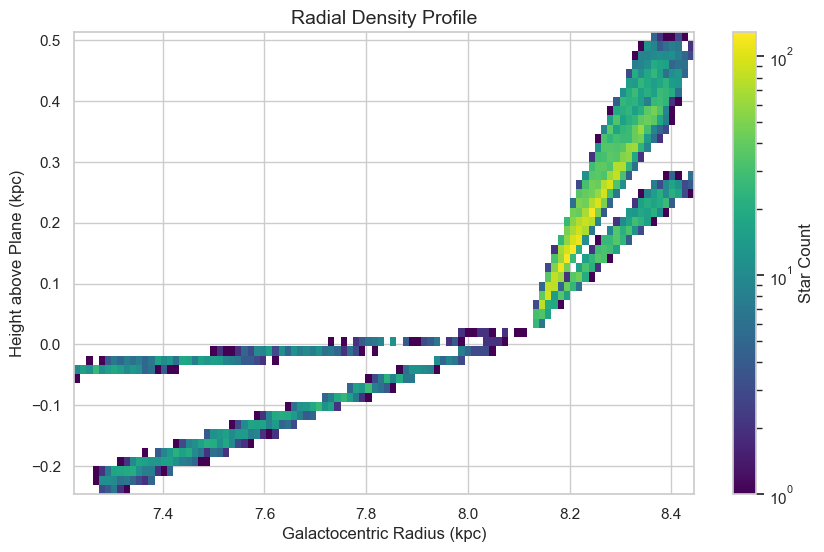

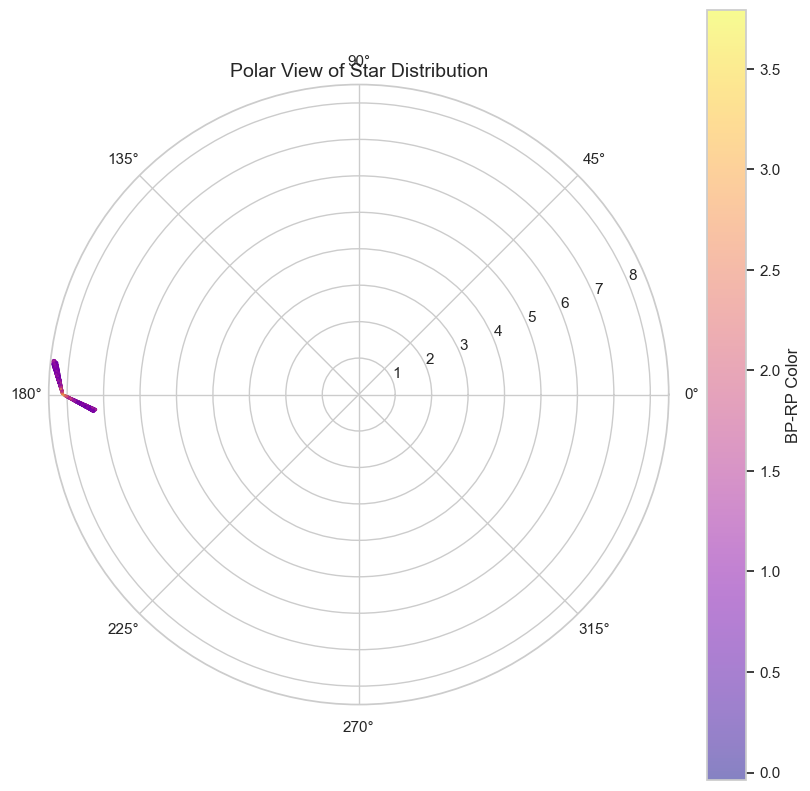

In [6]:
# Radial density profile
plt.figure(figsize=(10, 6))
r = np.sqrt(gaia_df['x_galcen_kpc']**2 + gaia_df['y_galcen_kpc']**2)
plt.hist2d(
    r,
    gaia_df['z_galcen_kpc'],
    bins=(100, 50),
    cmap='viridis',
    norm='log'
)
plt.colorbar(label='Star Count')
plt.title('Radial Density Profile', fontsize=14)
plt.xlabel('Galactocentric Radius (kpc)')
plt.ylabel('Height above Plane (kpc)')
plt.savefig('radial_profile.png', dpi=300)
plt.show()

# Create a polar plot of star distribution
theta = np.arctan2(gaia_df['y_galcen_kpc'], gaia_df['x_galcen_kpc'])
plt.figure(figsize=(10, 10))
plt.subplot(111, projection='polar')
plt.scatter(
    theta,
    r,
    c=gaia_df['bp_rp'],
    cmap='plasma',
    s=1,
    alpha=0.5
)
plt.colorbar(label='BP-RP Color')
plt.title('Polar View of Star Distribution', fontsize=14)
plt.savefig('polar_view.png', dpi=300)
plt.show()